In [1]:
#############################
## Check out central metrics for all libraries together + process

# Load Libraries

In [2]:
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scanorama
import os
import multiprocessing
import random
import time
import git
import sys
from datetime import date

# Load Data

## Configurations

### Technical configurations

In [3]:
multiprocessing.cpu_count()  ### total amount of cpu on the used core

96

In [4]:
len(os.sched_getaffinity(0)) ### amount of available cpus

24

In [5]:
sc.settings.n_jobs   # default number of CPUs to use for parallel computing

1

In [6]:
sc.settings.max_memory  # maximum memory to use in GB

15

In [7]:
random.seed(7)

In [8]:
ncore = '16'

In [9]:
random_state_var = 0

In [10]:
os.environ["OMP_NUM_THREADS"] = ncore
os.environ["OPENBLAS_NUM_THREADS"] = ncore
os.environ["MKL_NUM_THREADS"] = ncore
os.environ["VECLIB_MAXIMUM_THREADS"] = ncore
os.environ["NUMEXPR_NUM_THREADS"] = ncore

In [11]:
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 0

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                 8.3.1
annoy               NA
anyio               NA
attr                21.2.0
babel               2.9.1
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
brotli              NA
certifi             2021.05.30
cffi                1.14.6
chardet             4.0.0
charset_normalizer  2.0.0
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
decorator           5.0.9
defusedxml       

In [12]:
file_name = 'A6_QC_RNA_Preprocessing_Libraries.ipynb'

In [13]:
repo = git.Repo('/home/icb/corinna.losert/projects/stark-stemi')

### Parameters

In [14]:
data_path = '../data/current'

In [15]:
data_path

'../data/current'

In [16]:
result_path = '../results/current'

In [17]:
libraries =['0001', '0002', '0003', '0004', '0005', '0006', '0007', '0008', '0009', '0010', '0011', '0012', '0013', '0014'] # reduced to only 4 libraries for testing

In [18]:
libraries_text = ['L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'L7', 'L8', 'L9', 'L10', 'L11', 'L12', 'L13', 'L14']

In [19]:
libraries_dict = {'0001': 'L1', '0002': 'L2', '0003': 'L3', '0004': 'L4', '0005': 'L5',  '0006': 'L6', '0007': 'L7', '0008': 'L8', '0009': 'L9', '0010': 'L10', '0011': 'L11', '0012': 'L12', '0013': 'L13', '0014': 'L14'}

## Meta-Data File

In [20]:
path = data_path + "/preprocessed-data/meta-data/Mapping_Hashtag_Sample.csv"
library_hashtag_mapping = pd.read_csv(path) 
print('Last modified' + time.ctime(os.path.getmtime(path)))

Last modifiedThu Sep  2 13:17:03 2021


In [21]:
# library_hashtag_mapping

## RNA data from A5

In [22]:
anndata_dict = dict.fromkeys(libraries_text)

In [23]:
anndata_dict

{'L1': None,
 'L2': None,
 'L3': None,
 'L4': None,
 'L5': None,
 'L6': None,
 'L7': None,
 'L8': None,
 'L9': None,
 'L10': None,
 'L11': None,
 'L12': None,
 'L13': None,
 'L14': None}

In [24]:
for key in anndata_dict:
    dataset_path = data_path + "/analysis/A/A5_Processed_" + key + '_rna_Final.h5ad'
    
    print(dataset_path)
    print('Last modified' + time.ctime(os.path.getmtime(dataset_path)))
    
    adata_orig = sc.read_h5ad(dataset_path)
    adata_orig.var_names_make_unique()  # make variable names unique
    sc.pp.filter_genes(adata_orig, min_cells=1)  # filter genes
    
    anndata_dict[key]= adata_orig # save anndata in dictionary
    anndata_dict[key].uns['data_load_time'] = time.ctime(os.path.getmtime(dataset_path))  # save the last modified timestamp of the data loaded
    anndata_dict[key].uns['data_load_name'] = dataset_path # save the data path of the data loaded 
    

../data/current/analysis/A/A5_Processed_L1_rna_Final.h5ad
Last modifiedFri Jan 20 11:33:51 2023
../data/current/analysis/A/A5_Processed_L2_rna_Final.h5ad
Last modifiedFri Jan 20 11:33:53 2023
../data/current/analysis/A/A5_Processed_L3_rna_Final.h5ad
Last modifiedFri Jan 20 11:33:59 2023
../data/current/analysis/A/A5_Processed_L4_rna_Final.h5ad
Last modifiedFri Jan 20 11:34:00 2023
../data/current/analysis/A/A5_Processed_L5_rna_Final.h5ad
Last modifiedFri Jan 20 11:34:03 2023
../data/current/analysis/A/A5_Processed_L6_rna_Final.h5ad
Last modifiedFri Jan 20 11:34:04 2023
../data/current/analysis/A/A5_Processed_L7_rna_Final.h5ad
Last modifiedFri Jan 20 11:34:06 2023
../data/current/analysis/A/A5_Processed_L8_rna_Final.h5ad
Last modifiedFri Jan 20 11:34:08 2023
../data/current/analysis/A/A5_Processed_L9_rna_Final.h5ad
Last modifiedFri Jan 20 11:34:10 2023
../data/current/analysis/A/A5_Processed_L10_rna_Final.h5ad
Last modifiedFri Jan 20 11:34:11 2023
../data/current/analysis/A/A5_Processed

In [25]:
### Short data check

In [26]:
anndata_dict['L1']

AnnData object with n_obs × n_vars = 20572 × 24253
    obs: 'nCount_HTO', 'nFeature_HTO', 'nCount_RNA', 'nFeature_RNA', 'percent_mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_final', 'name', 'library', 'id', 'read', 'pattern', 'sequence', 'feature_type', 'Unnamed: 7', 'in_sample', 'display_name', 'group', 'HTO_Doublet_Classification', 'doublet_score', 'predicted_doublet', 'A5_scrublet_predicted_doublet_lib0.1', 'A5_scrublet_doublet_score_lib_0.1', 'A5_scrublet_predicted_doublet_lib0.2', 'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib', 'A5_scrublet_doublet_score_lib'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'data_load_name', 'data_load_time', 'data_save_name', 'data_save_time', 'scrublet'

In [27]:
anndata_dict['L1'].X.sum(axis=1)

matrix([[6685.],
        [3167.],
        [7907.],
        ...,
        [4105.],
        [4064.],
        [7344.]])

# Track changes in cell count distribution by filtering

In [28]:
cell_distribution = {}

In [29]:
for key in anndata_dict:
    cell_distribution[key] = anndata_dict[key].obs['HTO_classification_final'].value_counts()
    cell_distribution[key] = pd.DataFrame(cell_distribution[key])
    cell_distribution[key].columns = ['Amount Before Filtering']

# Filtering of genes and cells

In [30]:
for key in anndata_dict:
    print(key)
    sc.pp.filter_cells(anndata_dict[key], min_genes = 200)
    sc.pp.filter_genes(anndata_dict[key], min_cells = 3)

L1
L2
L3
L4
L5
L6
L7
L8
L9
L10
L11
L12
L13
L14


In [31]:
#### Save effect of sample cell distribution
for key in anndata_dict:
    cell_distribution_basic_filter = anndata_dict[key].obs['HTO_classification_final'].value_counts()  # check out the distribution of cells per sample in object
    cell_distribution_basic_filter =  pd.DataFrame(cell_distribution_basic_filter)
    cell_distribution_basic_filter.columns = ['Amount_after_basic_filtering']
    cell_distribution[key] = cell_distribution[key].join(cell_distribution_basic_filter)

In [32]:
cell_distribution

{'L1':           Amount Before Filtering  Amount_after_basic_filtering
 Doublet                      4882                          4875
 9.1                          2889                          2858
 2.1                          2826                          2813
 Negative                     2353                          2331
 1.1                          2327                          2325
 8.1                          1535                          1524
 4.1                          1464                          1452
 7.1                          1354                          1350
 5.1                           942                           935,
 'L2':           Amount Before Filtering  Amount_after_basic_filtering
 Doublet                      6043                          5980
 13.1                         3318                          3240
 Negative                     1981                          1969
 19.1                         1793                          1789
 18.1       

# Check out QC metrics for all libraries + filter out extreme values

## Calculate the QC metrics for the libraries

In [33]:
#### Calculate the QC metrics for the libraries
for key in anndata_dict:
    anndata_dict[key].var['mt'] = anndata_dict[key].var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
    anndata_dict[key].var['rb'] = np.logical_or (anndata_dict[key].var_names.str.startswith('RPS'),  anndata_dict[key].var_names.str.startswith('RPL')) # annotate the group of ribosomal genes as 'rb'
    
    sc.pp.calculate_qc_metrics(anndata_dict[key], qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [34]:
# anndata_dict[key].var_names[np.logical_or (anndata_dict[key].var_names.str.startswith('RPS'),  anndata_dict[key].var_names.str.startswith('RPL'))]
# test getting ribosomal genes

## Set thresholds for filtering of the data

In [35]:
#### Set thresholds for filtering of the data
threshold_max_pct_counts_mt = 15
threshold_min_n_genes_by_counts = 500
threshold_max_n_genes_by_counts = 5000
threshold_total_counts = 20000

In [36]:
### Add threshold filters for each anndata object
for key in anndata_dict:
    filter_condition_dying_cells = (anndata_dict[key].obs.n_genes_by_counts > threshold_min_n_genes_by_counts) & (anndata_dict[key].obs.pct_counts_mt < threshold_max_pct_counts_mt)
    filter_condition_doublets = (anndata_dict[key].obs.n_genes_by_counts < threshold_max_n_genes_by_counts) & (anndata_dict[key].obs.total_counts < threshold_total_counts)
    anndata_dict[key].obs['valid_cell_filter_dying'] = filter_condition_dying_cells  # annotate cells that might be dying according to set filter threshold
    anndata_dict[key].obs['valid_cell_filter_doublet'] = filter_condition_doublets  # annotate cells that might be doublets according to set filter threshold 
    

In [37]:
anndata_dict['L1'].obs

,nCount_HTO,nFeature_HTO,nCount_RNA,nFeature_RNA,percent_mt,HTO_maxID,HTO_secondID,HTO_margin,HTO_classification,HTO_classification.global,...,A5_scrublet_doublet_score_lib_0.2,A5_scrublet_predicted_doublet_lib,A5_scrublet_doublet_score_lib,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,valid_cell_filter_dying,valid_cell_filter_doublet
AAACCCAAGTAGGAAG-1,414.0,7,6685.0,1696,7.240090,8.1,1.1,0.051745,1.1_8.1,Doublet,...,0.379455,False,0.379455,1696,1696,6685.0,484.0,7.240090,True,True
AAACCCAAGTAGGGTC-1,226.0,7,3167.0,904,7.388696,9.1,5.1,0.464226,Negative,Negative,...,0.330798,False,0.330798,904,904,3167.0,234.0,7.388696,True,True
AAACCCACAAGAAATC-1,601.0,7,7907.0,1732,6.867333,1.1,2.1,0.704262,1.1_2.1,Doublet,...,0.312614,False,0.312614,1732,1732,7907.0,543.0,6.867333,True,True
AAACCCACAATACGCT-1,8353.0,7,15367.0,3905,7.483569,2.1,8.1,3.892705,2.1_8.1,Doublet,...,0.324578,False,0.324578,3905,3905,15367.0,1150.0,7.483569,True,True
AAACCCACACCACATA-1,833.0,7,7165.0,2130,6.322401,4.1,1.1,0.363664,1.1_4.1,Doublet,...,0.189333,False,0.189333,2130,2130,7165.0,453.0,6.322401,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCACCTTAT-1,1120.0,7,7187.0,2480,6.024767,7.1,2.1,0.638372,2.1_7.1,Doublet,...,0.469287,False,0.469287,2480,2480,7187.0,433.0,6.024767,True,True
TTTGTTGTCAGACTGT-1,353.0,7,4259.0,1261,5.541207,5.1,8.1,1.482897,5.1,Singlet,...,0.155875,False,0.155875,1261,1261,4259.0,236.0,5.541207,True,True
TTTGTTGTCCGTAGGC-1,250.0,7,4105.0,1250,2.752741,7.1,5.1,1.618696,7.1,Singlet,...,0.168961,False,0.168961,1250,1250,4105.0,113.0,2.752741,True,True
TTTGTTGTCGGAGATG-1,488.0,7,4064.0,1185,5.585630,9.1,8.1,0.644727,9.1,Singlet,...,0.150943,False,0.150943,1185,1185,4064.0,227.0,5.585630,True,True


## Plot gene expression distribution 

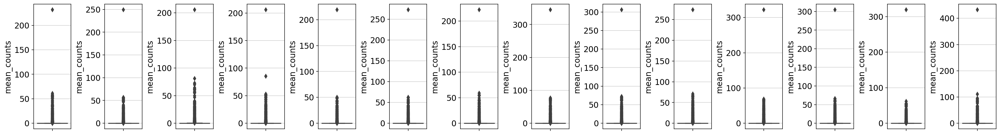

In [38]:
#### Mean counts per gene ( = sum counts of gene/ amount of cells)

#### Plot gene expression again after filtering; would be interesting after highly variable genes

fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14) = plt.subplots(1, 14, figsize=(30,4 ), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7, 'L8': ax8, 'L9': ax9, 'L10': ax10, 'L11': ax11, 'L12': ax12, 'L13': ax13, 'L14': ax14}

for key in anndata_dict:
    #print('Distribution of gene expression: ' + key)
    #print('With Outliers')
    ax1 = sns.boxplot( y = anndata_dict[key].var["mean_counts"], showfliers=True, ax =axes_dictionary[key] )
    # mpl.pyplot.show()

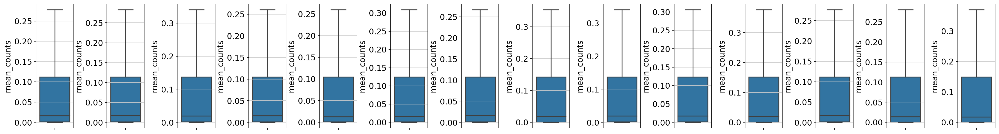

In [39]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14) = plt.subplots(1, 14, figsize=(30,4 ), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7, 'L8': ax8, 'L9': ax9, 'L10': ax10, 'L11': ax11, 'L12': ax12, 'L13': ax13, 'L14': ax14}

for key in anndata_dict:
    #print('Distribution of gene expression: ' + key)
    #print('With Outliers')
    ax1 = sns.boxplot( y = anndata_dict[key].var["mean_counts"], showfliers=False, ax =axes_dictionary[key] )
    # mpl.pyplot.show()

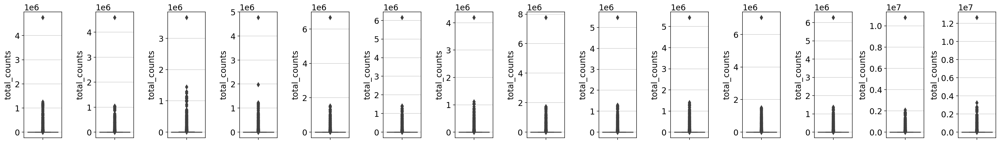

In [40]:
#### Plot gene expression distribution / total counts per gene 

fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14) = plt.subplots(1, 14, figsize=(30,4 ), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7, 'L8': ax8, 'L9': ax9, 'L10': ax10, 'L11': ax11, 'L12': ax12, 'L13': ax13, 'L14': ax14}

for key in anndata_dict:
    #print('Distribution of gene expression: ' + key)
    #print('With Outliers')
    ax1 = sns.boxplot( y = anndata_dict[key].var["total_counts"], showfliers=True, ax =axes_dictionary[key] )
    # mpl.pyplot.show()

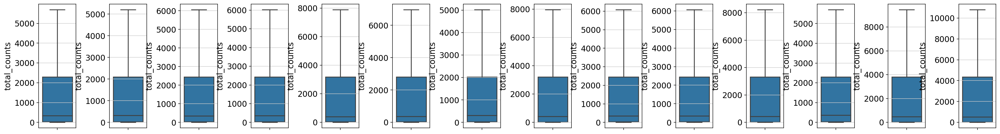

In [41]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14) = plt.subplots(1, 14, figsize=(30,4 ), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7, 'L8': ax8, 'L9': ax9, 'L10': ax10, 'L11': ax11, 'L12': ax12, 'L13': ax13, 'L14': ax14}

for key in anndata_dict:
    #print('Distribution of gene expression: ' + key)
    #print('With Outliers')
    ax1 = sns.boxplot( y = anndata_dict[key].var["total_counts"], showfliers=False, ax =axes_dictionary[key] )
    # mpl.pyplot.show()

In [42]:
genes_high_counts = []

for key in anndata_dict:
    genes_high_counts = genes_high_counts + list((anndata_dict[key].var[anndata_dict[key].var['total_counts'] > 6000].index )) # list of genes with extremely high counts
    genes_high_counts = genes_high_counts + list(anndata_dict[key].var[anndata_dict[key].var['mean_counts'] > 0.3].index) # list of genes with extremely high mean counts

In [43]:
len(pd.unique(genes_high_counts))   # across all libraries; TBD - seperately for each library

4693

In [44]:
##### Example for library 1
anndata_dict['L1'].var[anndata_dict['L1'].var['total_counts'] > 6000].index # list of genes with extremely high counts

Index(['ISG15', 'SDF4', 'AURKAIP1', 'MRPL20', 'SSU72', 'GNB1', 'FAAP20',
       'RER1', 'TNFRSF14', 'RPL22',
       ...
       'MT-CO2', 'MT-ATP8', 'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4',
       'MT-ND5', 'MT-ND6', 'MT-CYB'],
      dtype='object', length=2357)

In [45]:
anndata_dict['L1'].var[anndata_dict['L1'].var['mean_counts'] > 0.3] # list of genes with extremely high mean counts

,gene_ids,feature_types,genome,n_cells,mt,rb,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts
ISG15,ENSG00000187608,0,0,6061,False,False,6061,0.485706,70.380687,9939.0
SDF4,ENSG00000078808,0,0,4929,False,False,4929,0.308410,75.912623,6311.0
AURKAIP1,ENSG00000175756,0,0,7662,False,False,7662,0.556419,62.556810,11386.0
MRPL20,ENSG00000242485,0,0,7288,False,False,7288,0.542687,64.384499,11105.0
SSU72,ENSG00000160075,0,0,8726,False,False,8726,0.669110,57.357181,13692.0
...,...,...,...,...,...,...,...,...,...,...
MT-ND4L,ENSG00000212907,0,0,15652,True,False,15652,2.379221,23.510727,48686.0
MT-ND4,ENSG00000198886,0,0,20413,True,False,20413,28.978644,0.244343,592990.0
MT-ND5,ENSG00000198786,0,0,20079,True,False,20079,8.919953,1.876558,182529.0
MT-ND6,ENSG00000198695,0,0,9612,True,False,9612,0.807018,53.027415,16514.0


## Plot count distribution for cells based on histogram 

/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


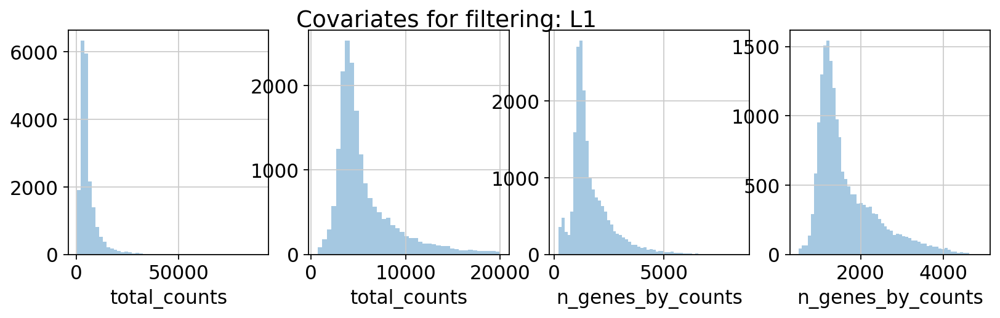

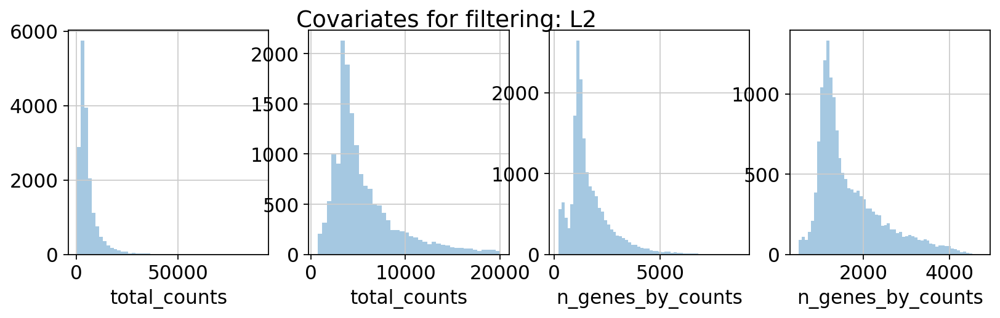

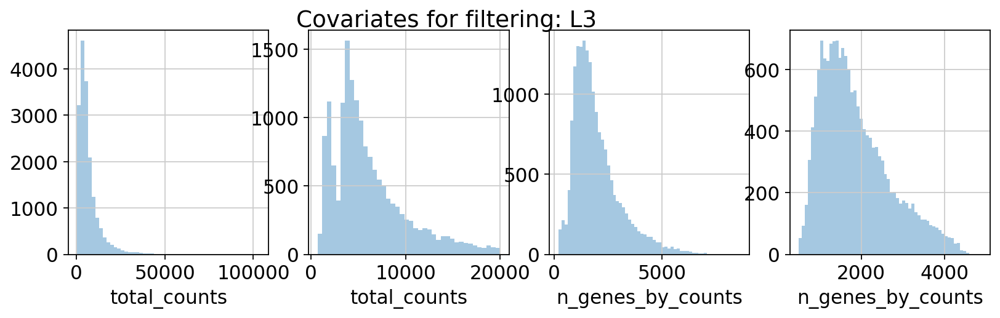

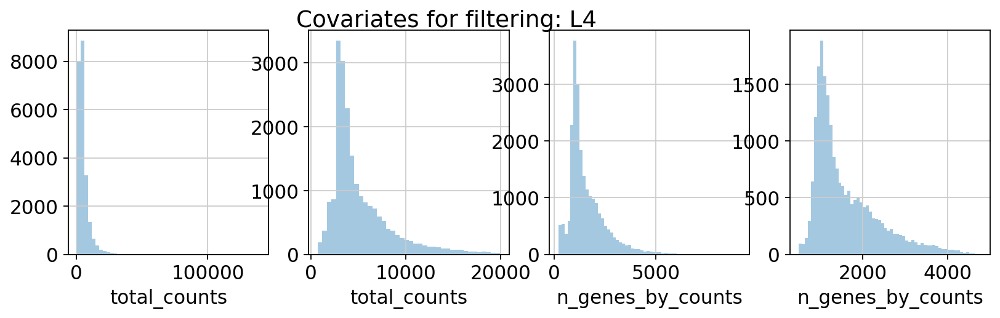

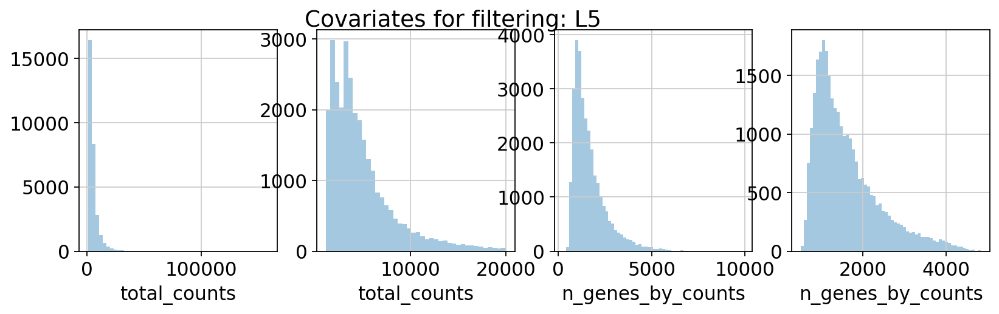

...

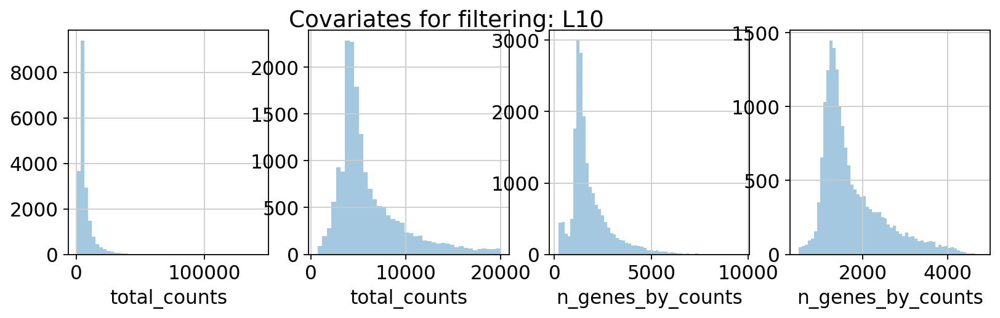

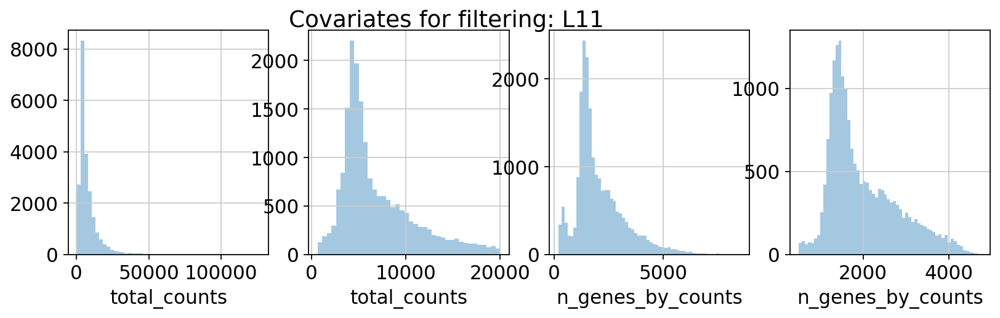

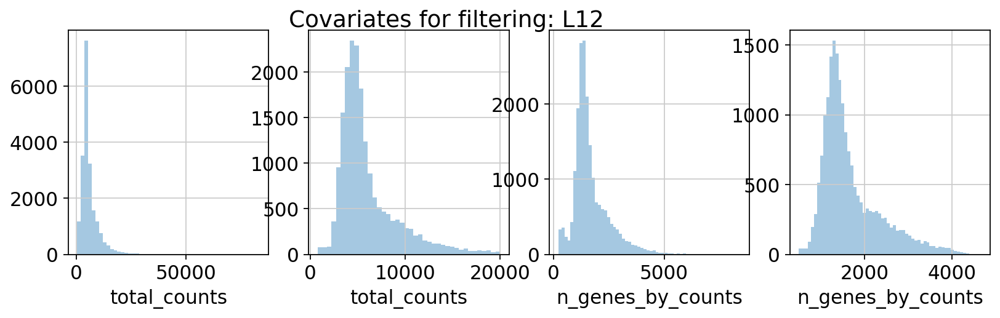

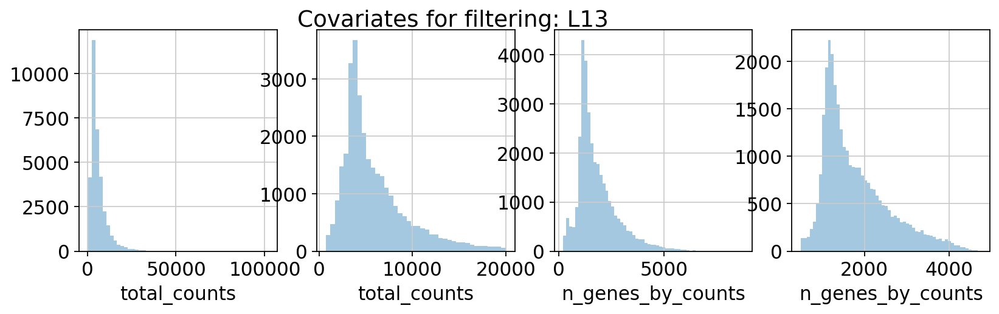

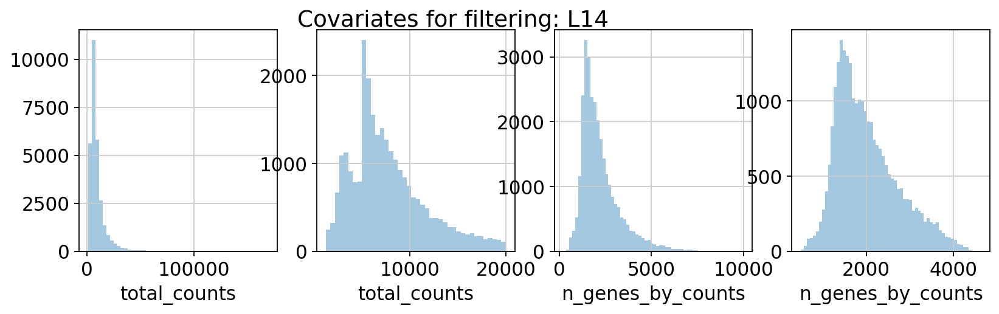

In [46]:
for key in anndata_dict:
    fig, axs = plt.subplots(1, 4, figsize=(12, 3))
    fig.suptitle("Covariates for filtering: " + key )

    sns.distplot( anndata_dict[key].obs["total_counts"], kde=False, ax=axs[0])
    sns.distplot(
        anndata_dict[key].obs["total_counts"][( anndata_dict[key].obs['valid_cell_filter_dying'] & anndata_dict[key].obs['valid_cell_filter_doublet'])],
        kde=False,
        bins=40,
        ax=axs[1],
    )
    sns.distplot(anndata_dict[key].obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
    sns.distplot(
        anndata_dict[key].obs["n_genes_by_counts"][( anndata_dict[key].obs['valid_cell_filter_dying'] & anndata_dict[key].obs['valid_cell_filter_doublet'])],
        kde=False,
        bins=60,
        ax=axs[3],
    )

Before Filtering L1



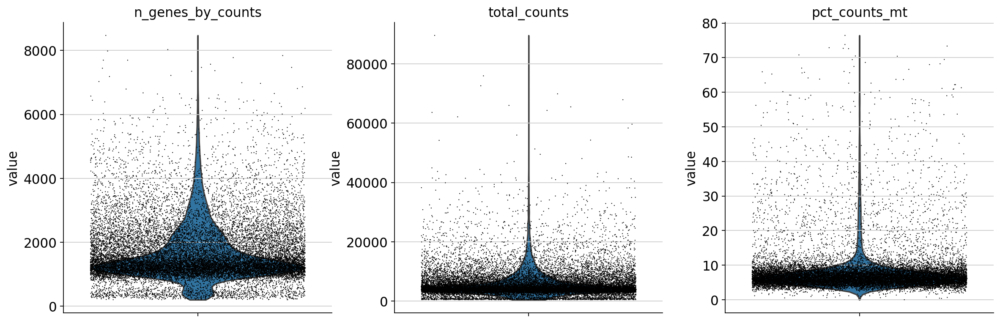

After filtering with thresholds L1



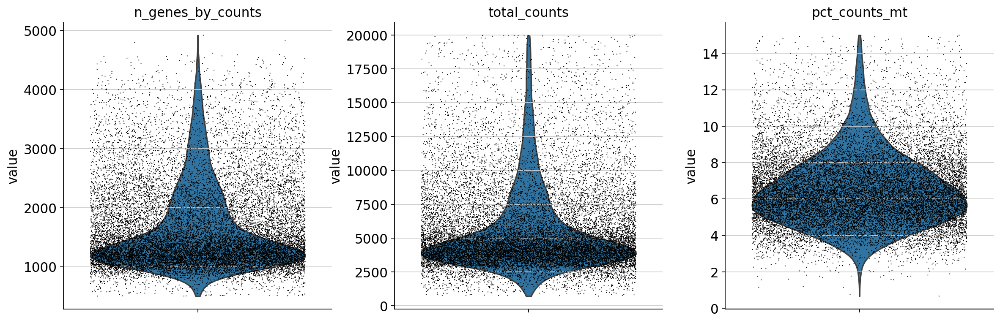

Before Filtering L2



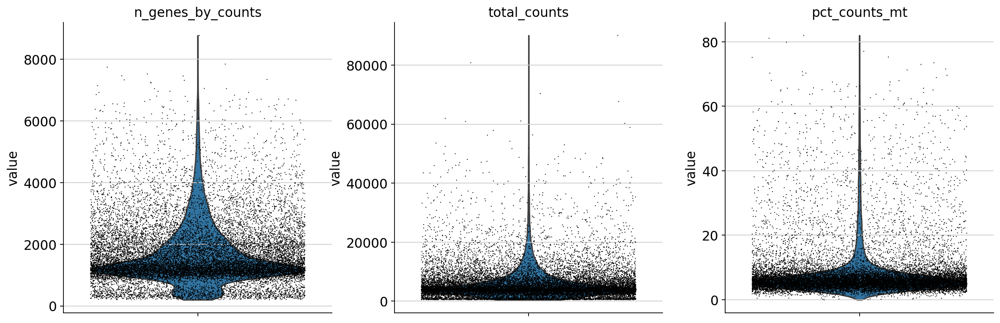

After filtering with thresholds L2



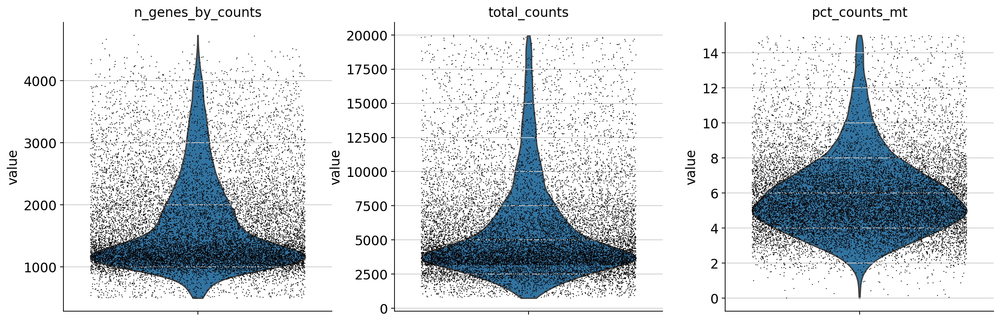

Before Filtering L3



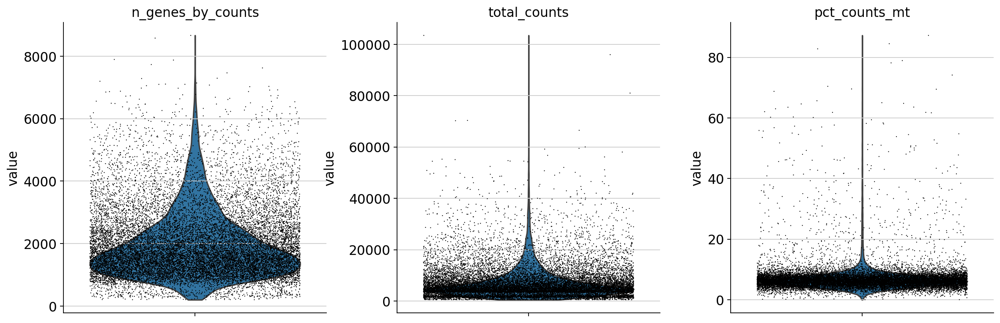

After filtering with thresholds L3



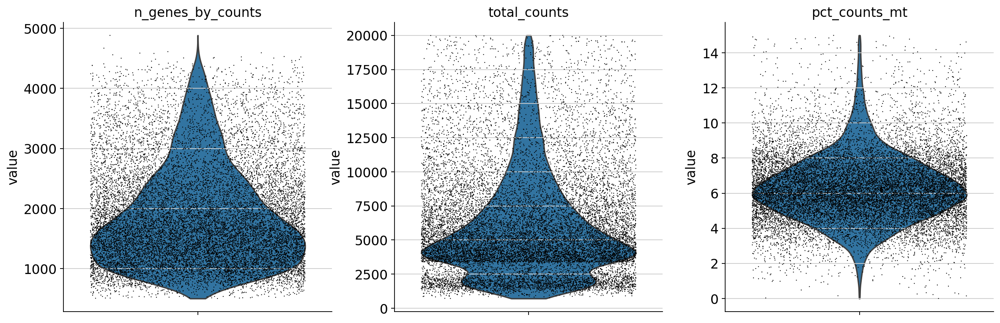

Before Filtering L4



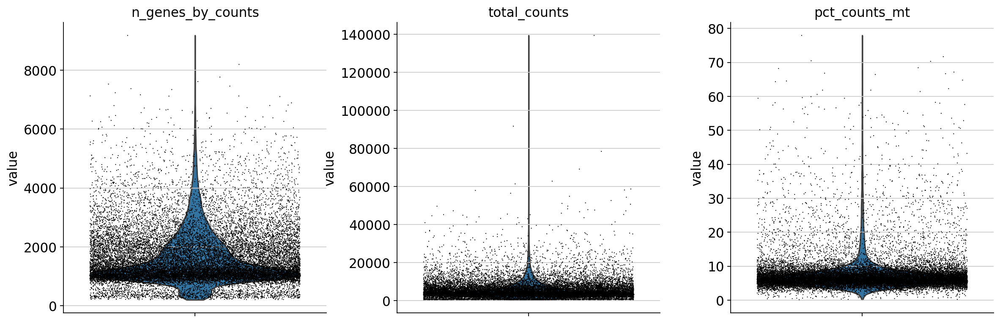

After filtering with thresholds L4



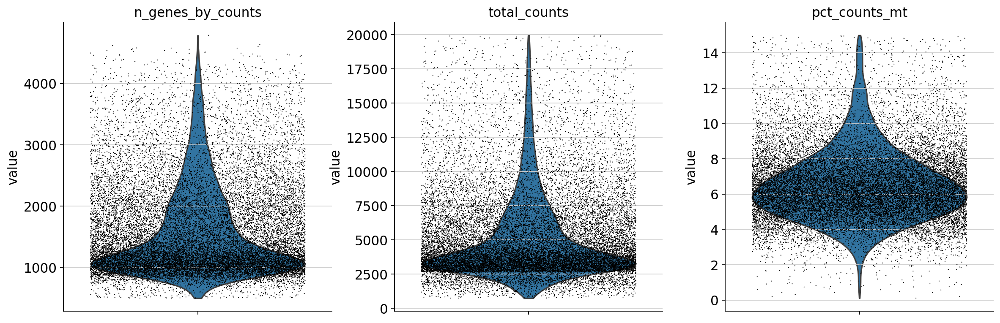

Before Filtering L5



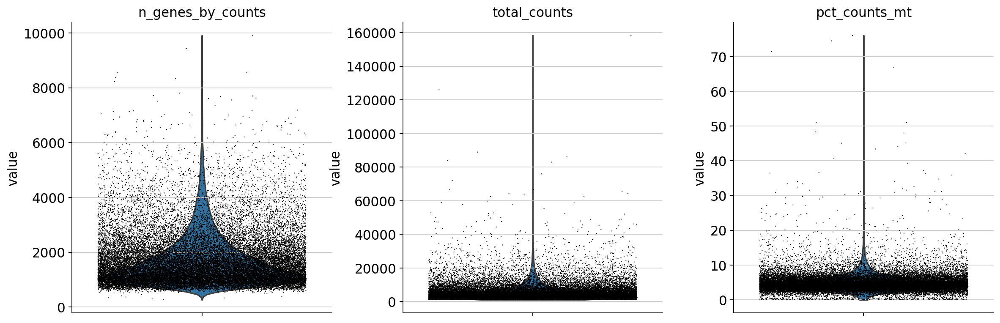

After filtering with thresholds L5



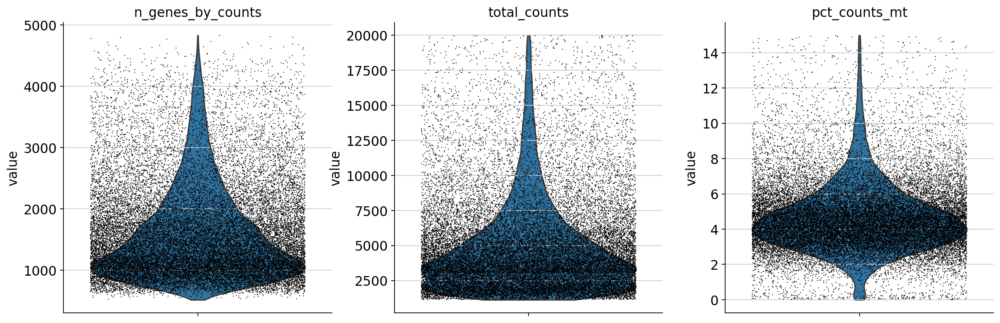

Before Filtering L6



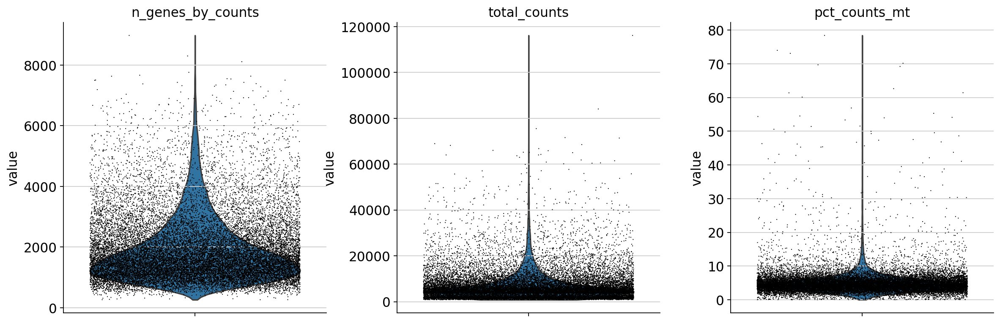

After filtering with thresholds L6



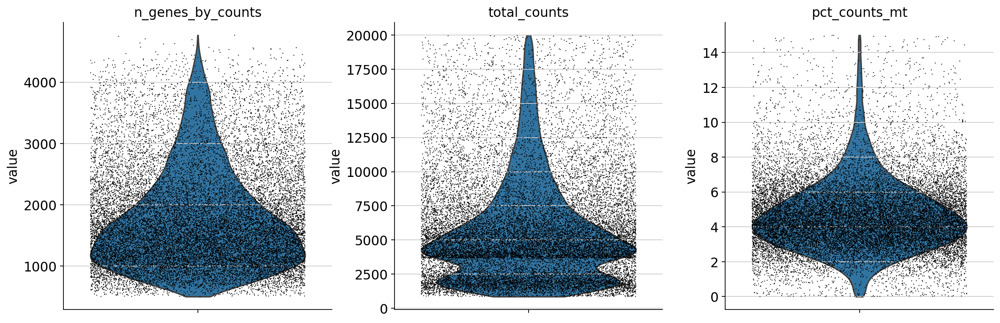

Before Filtering L7



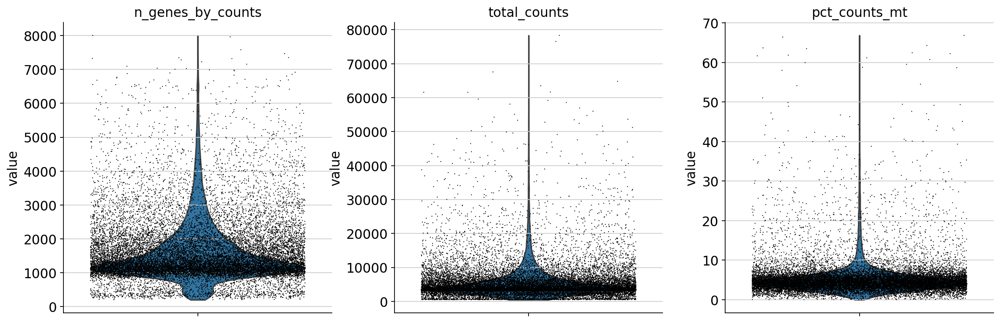

After filtering with thresholds L7



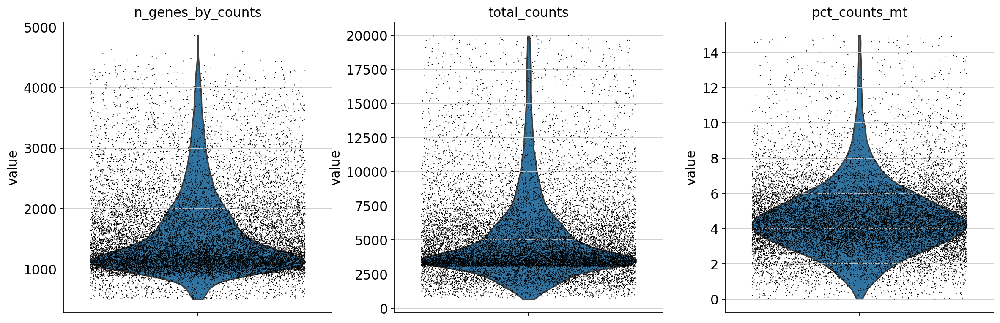

Before Filtering L8



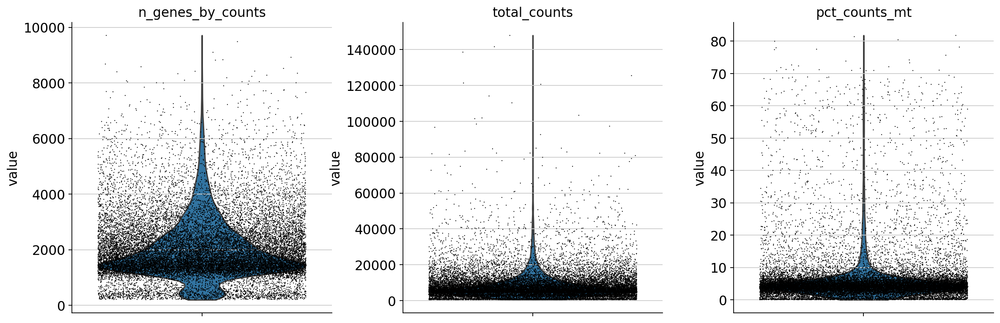

After filtering with thresholds L8



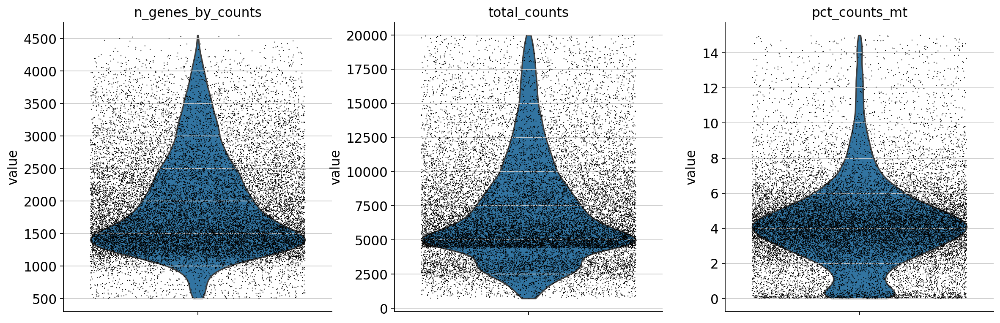

Before Filtering L9



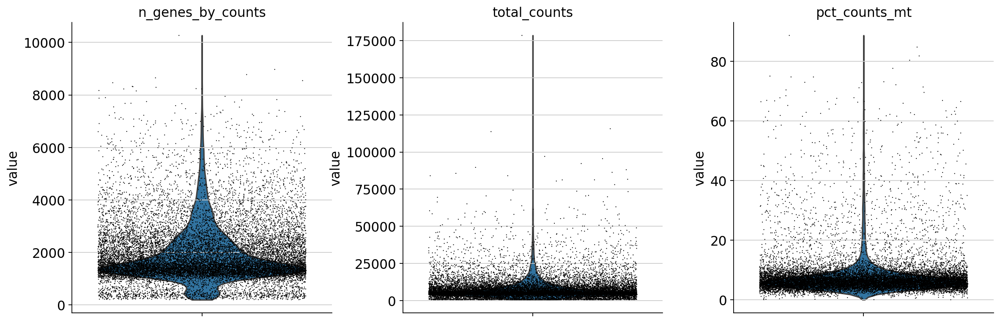

After filtering with thresholds L9



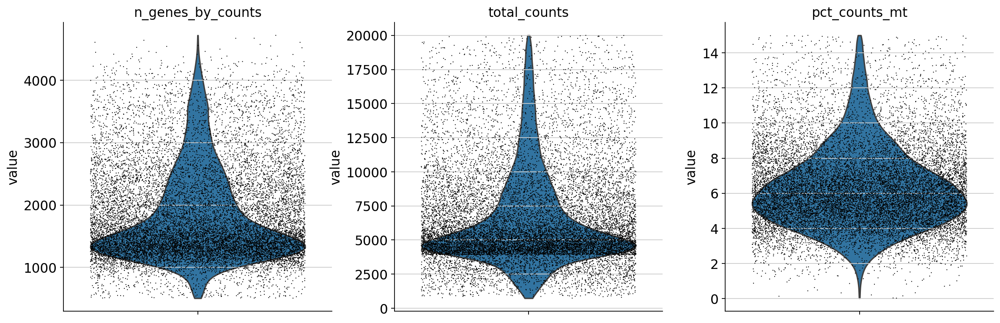

Before Filtering L10



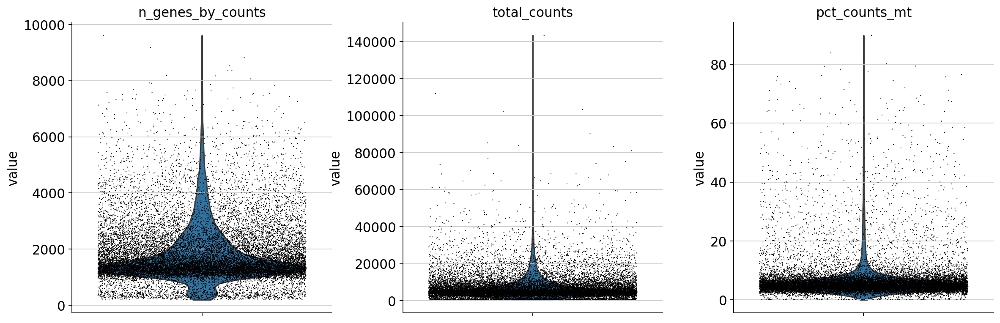

After filtering with thresholds L10



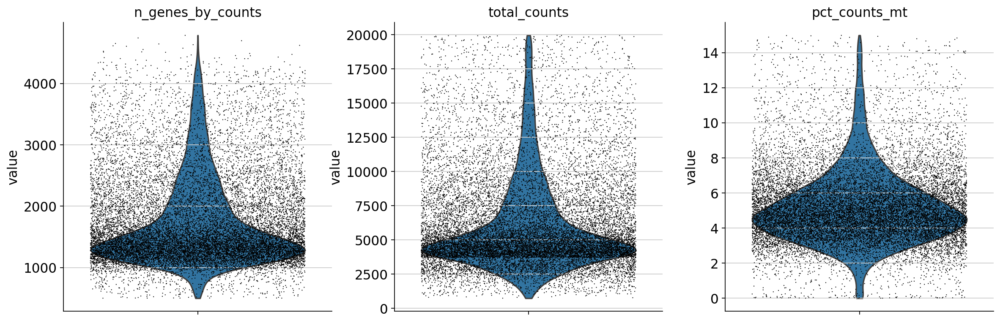

Before Filtering L11



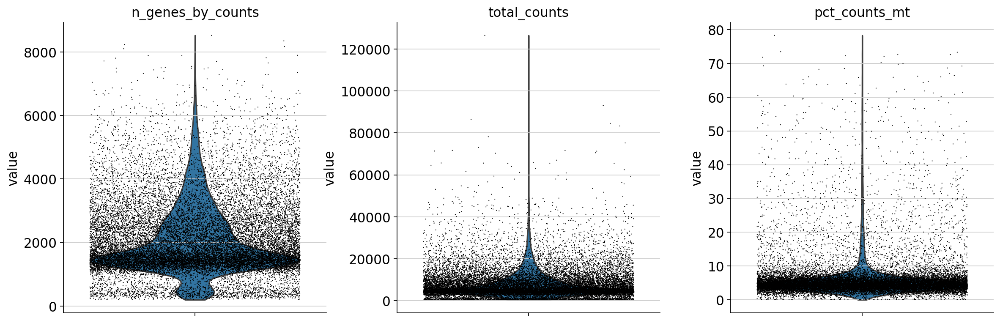

After filtering with thresholds L11



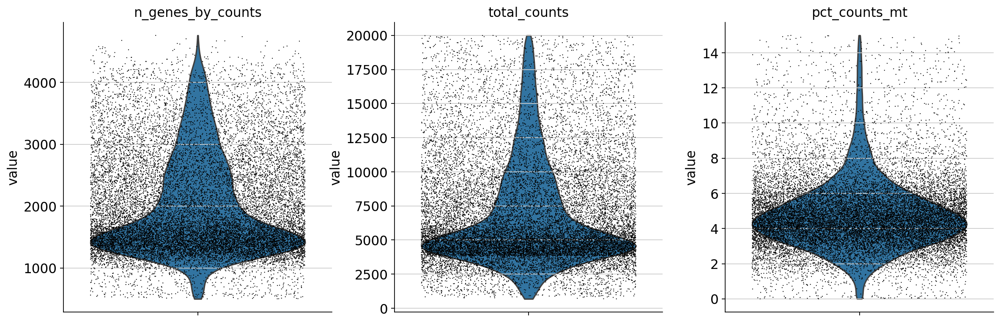

Before Filtering L12



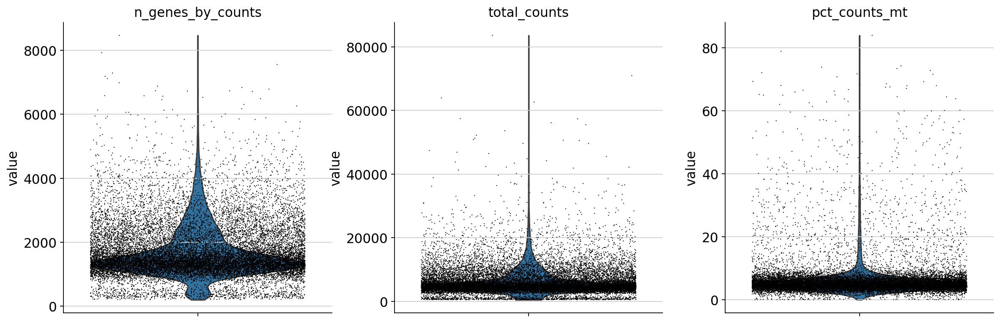

After filtering with thresholds L12



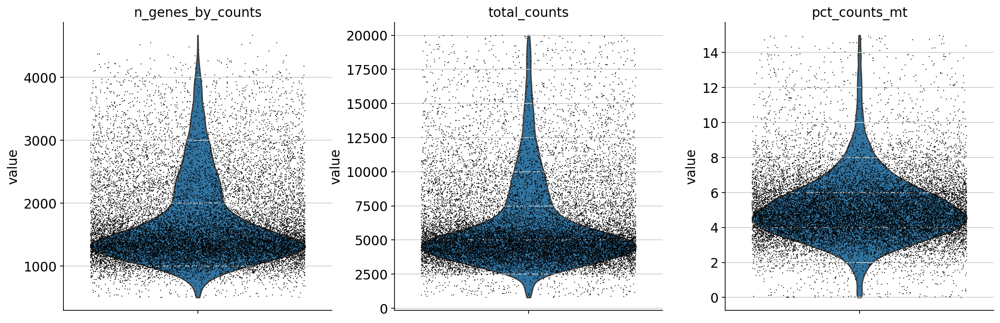

Before Filtering L13



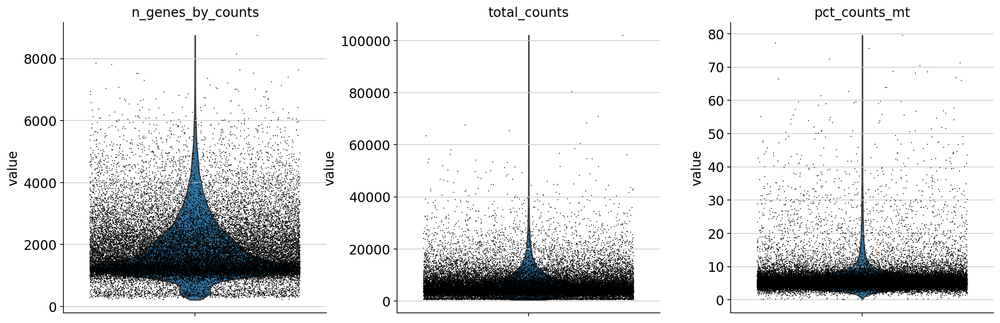

After filtering with thresholds L13



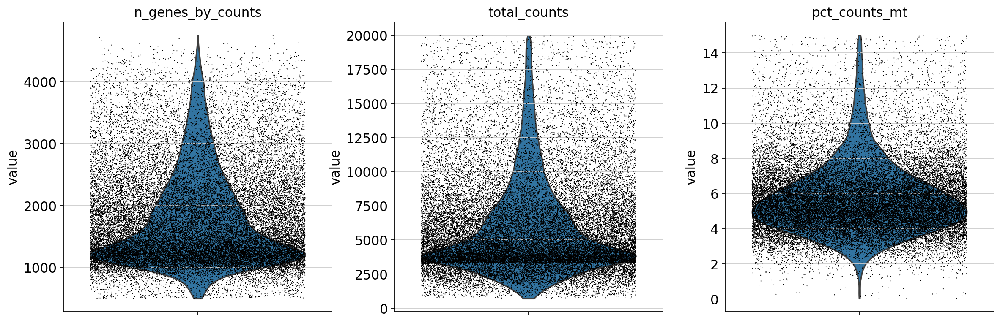

Before Filtering L14



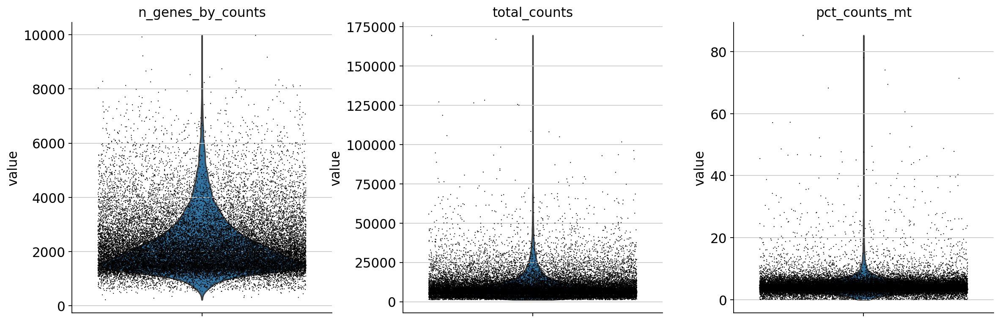

After filtering with thresholds L14



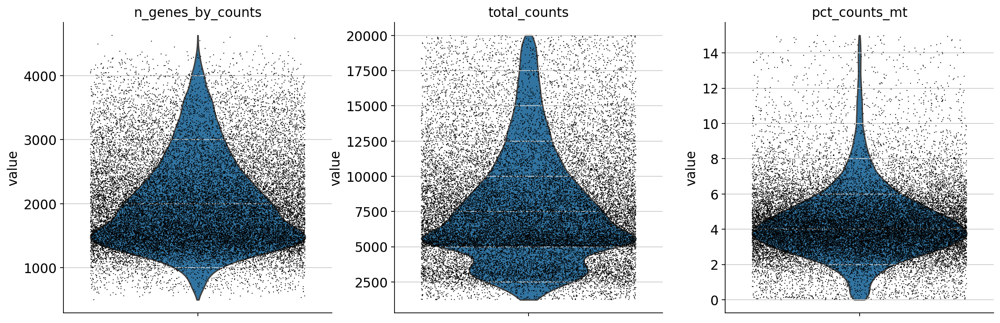

In [47]:
##### Plot distribution of central measures before and after filtering the data  for each library 
for key in anndata_dict:
    print('Before Filtering ' + key)
    print('')
    sc.pl.violin(anndata_dict[key], ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
    
    print('After filtering with thresholds ' + key)
    print('')
    #anndata_dict[key] =   anndata_dict[key][( anndata_dict[key].obs['valid_cell_filter_dying'] & anndata_dict[key].obs['valid_cell_filter_doublet']) , :]
    sc.pl.violin(anndata_dict[key][(anndata_dict[key].obs['valid_cell_filter_dying'] & anndata_dict[key].obs['valid_cell_filter_doublet'])], ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

## Plot gene expression distribution after filtering cell counts

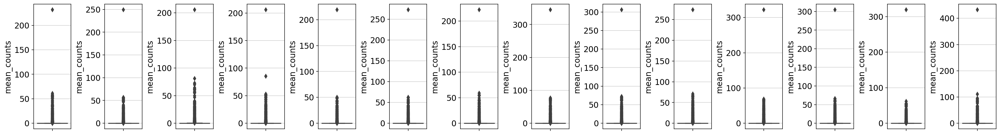

In [48]:
#### Plot gene expression again after filtering; would be interesting after highly variable genes

fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14) = plt.subplots(1, 14, figsize=(30,4 ), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7, 'L8': ax8, 'L9': ax9, 'L10': ax10, 'L11': ax11, 'L12': ax12, 'L13': ax13, 'L14': ax14}

for key in anndata_dict:
    #print('Distribution of gene expression: ' + key)
    #print('With Outliers')
    ax1 = sns.boxplot( y = anndata_dict[key].var["mean_counts"], showfliers=True, ax =axes_dictionary[key] )
    # mpl.pyplot.show()

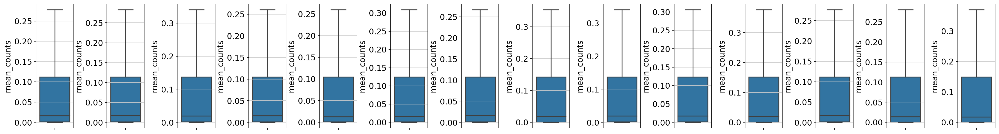

In [49]:
#### Plot gene expression again after filtering; would be interesting after highly variable genes

fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14) = plt.subplots(1, 14, figsize=(30,4 ), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7, 'L8': ax8, 'L9': ax9, 'L10': ax10, 'L11': ax11, 'L12': ax12, 'L13': ax13, 'L14': ax14}

for key in anndata_dict:
    #print('Without Outliers')
    ax2 = sns.boxplot(y = anndata_dict[key].var["mean_counts"], showfliers=False, ax =axes_dictionary[key])
    #mpl.pyplot.show()

## Check out highly variable genes

In [50]:
### Plot highly variable genes

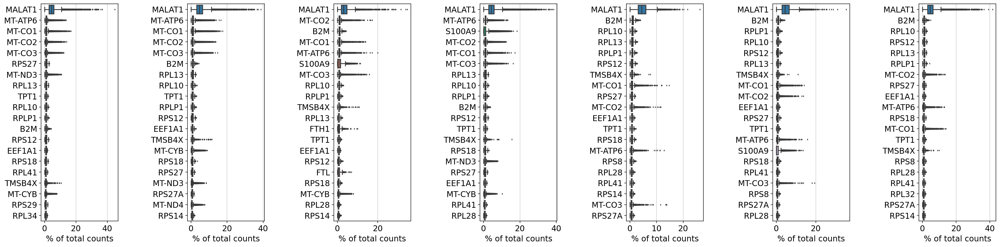

In [51]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(1, 7, figsize=(30,7), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7}

for key in axes_dictionary:
    #print('Highly variable genes for ' + key)
    ax = sc.pl.highest_expr_genes(anndata_dict[key], n_top=20, ax = axes_dictionary[key], show = False)   ## Seurat object combined with cellranger counts
    #print('')

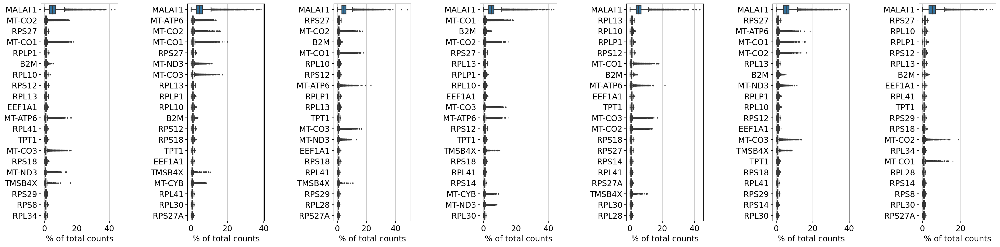

In [52]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(1, 7, figsize=(30,7 ), gridspec_kw={'wspace':0.9})
axes_dictionary = { 'L8': ax1, 'L9': ax2, 'L10': ax3, 'L11': ax4, 'L12': ax5, 'L13': ax6, 'L14': ax7}

for key in axes_dictionary:
    #print('Highly variable genes for ' + key)
    ax = sc.pl.highest_expr_genes(anndata_dict[key], n_top=20, ax = axes_dictionary[key], show = False)   ## Seurat object combined with cellranger counts
    #print('')

In [53]:
### Test removing mitochondrial + ribosomal genes and plot without those genes

In [54]:
anndata_dict['L1'][:,np.logical_and(anndata_dict['L1'].var['rb'] == False , anndata_dict['L1'].var['mt'] == False)]  # filter out ribosomal + mitochondrial genes

View of AnnData object with n_obs × n_vars = 20463 × 21302
    obs: 'nCount_HTO', 'nFeature_HTO', 'nCount_RNA', 'nFeature_RNA', 'percent_mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_final', 'name', 'library', 'id', 'read', 'pattern', 'sequence', 'feature_type', 'Unnamed: 7', 'in_sample', 'display_name', 'group', 'HTO_Doublet_Classification', 'doublet_score', 'predicted_doublet', 'A5_scrublet_predicted_doublet_lib0.1', 'A5_scrublet_doublet_score_lib_0.1', 'A5_scrublet_predicted_doublet_lib0.2', 'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib', 'A5_scrublet_doublet_score_lib', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'valid_cell_filter_dying', 'valid_cell_filter_doublet'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'data_load_nam

In [55]:
anndata_dict['L1']    # fitered out 113 genes

AnnData object with n_obs × n_vars = 20463 × 21415
    obs: 'nCount_HTO', 'nFeature_HTO', 'nCount_RNA', 'nFeature_RNA', 'percent_mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_final', 'name', 'library', 'id', 'read', 'pattern', 'sequence', 'feature_type', 'Unnamed: 7', 'in_sample', 'display_name', 'group', 'HTO_Doublet_Classification', 'doublet_score', 'predicted_doublet', 'A5_scrublet_predicted_doublet_lib0.1', 'A5_scrublet_doublet_score_lib_0.1', 'A5_scrublet_predicted_doublet_lib0.2', 'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib', 'A5_scrublet_doublet_score_lib', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'valid_cell_filter_dying', 'valid_cell_filter_doublet'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'data_load_name', 'dat

/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarn

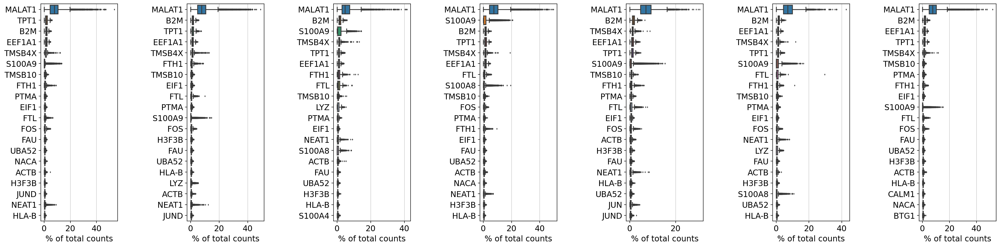

In [56]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(1, 7, figsize=(30,7), gridspec_kw={'wspace':0.9})
axes_dictionary = {'L1': ax1, 'L2': ax2, 'L3': ax3, 'L4': ax4, 'L5': ax5, 'L6': ax6, 'L7': ax7}

for key in axes_dictionary:
    #print('Highly variable genes for ' + key)
    ax = sc.pl.highest_expr_genes(anndata_dict[key][:,np.logical_and(anndata_dict[key].var['rb'] == False , anndata_dict[key].var['mt'] == False)] , n_top=20, ax = axes_dictionary[key], show = False)   ## Seurat object combined with cellranger counts
    #print('')

/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarn

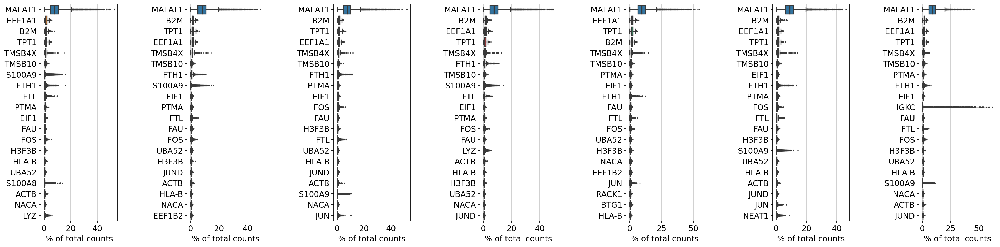

In [57]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(1, 7, figsize=(30,7 ), gridspec_kw={'wspace':0.9})
axes_dictionary = { 'L8': ax1, 'L9': ax2, 'L10': ax3, 'L11': ax4, 'L12': ax5, 'L13': ax6, 'L14': ax7}

for key in axes_dictionary:
    #print('Highly variable genes for ' + key)
    ax = sc.pl.highest_expr_genes(anndata_dict[key][:,np.logical_and(anndata_dict[key].var['rb'] == False , anndata_dict[key].var['mt'] == False)], n_top=20, ax = axes_dictionary[key], show = False)   ## Seurat object combined with cellranger counts
    #print('')

# Data Transformation and Reduction (Normalization, Log, HVG, Scaling)

## Apply some filters and add layers to data

In [58]:
for key in anndata_dict:
    print(key)
    
    # filter the data
    anndata_dict[key] =   anndata_dict[key][( anndata_dict[key].obs['valid_cell_filter_dying'] & anndata_dict[key].obs['valid_cell_filter_doublet']) , :]
    
    # generate some data transformation layers & apply transformations
    
    anndata_dict[key].layers['A6_normalized'] = sc.pp.normalize_total(anndata_dict[key], target_sum=1e4, copy = True).X
    anndata_dict[key].layers['A6_normalized_log']  = sc.pp.log1p(anndata_dict[key].layers['A6_normalized'], copy = True)
    # TBD: add normalized + scaled layer
    
    sc.pp.highly_variable_genes(anndata_dict[key], min_mean=0.0125, max_mean=3, min_disp=0.5, layer = 'A6_normalized_log')
    
    anndata_dict[key].obsm['A6_only_highly_variable'] = anndata_dict[key][:,anndata_dict[key].var['highly_variable']==True].X
    
    # store raw count matrix as backup
    anndata_dict[key].raw = anndata_dict[key]
    
    # apply some data transformations
    sc.pp.normalize_total(anndata_dict[key], target_sum=1e4, inplace=True)
    sc.pp.log1p(anndata_dict[key])
    
    anndata_dict[key].obsm['A6_only_highly_variable'] = anndata_dict[key][:,anndata_dict[key].var['highly_variable']==True].X
    # anndata_dict[key].cluster = anndata_dict[key][:,anndata_dict[key].var['highly_variable']==True]
    
    # regress out total counts and mt effects
    # sc.pp.regress_out(anndata_dict[key].cluster, ['total_counts', 'pct_counts_mt'])
    
    # scale the gene expression values
    # sc.pp.scale(anndata_dict[key].cluster, max_value=10)
    
    # anndata_dict[key].obsm['A6_only_highly_variable_processed'] = anndata_dict[key].cluster.X
    
    # last part ist executed in next script
    

L1
L2
L3
L4
L5
L6
L7
L8
L9
L10
L11
L12
L13
L14


In [59]:
anndata_dict['L1']

AnnData object with n_obs × n_vars = 18549 × 21415
    obs: 'nCount_HTO', 'nFeature_HTO', 'nCount_RNA', 'nFeature_RNA', 'percent_mt', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'HTO_classification_final', 'name', 'library', 'id', 'read', 'pattern', 'sequence', 'feature_type', 'Unnamed: 7', 'in_sample', 'display_name', 'group', 'HTO_Doublet_Classification', 'doublet_score', 'predicted_doublet', 'A5_scrublet_predicted_doublet_lib0.1', 'A5_scrublet_doublet_score_lib_0.1', 'A5_scrublet_predicted_doublet_lib0.2', 'A5_scrublet_doublet_score_lib_0.2', 'A5_scrublet_predicted_doublet_lib', 'A5_scrublet_doublet_score_lib', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'valid_cell_filter_dying', 'valid_cell_filter_doublet'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'd

In [60]:
### Do some short checks on transfomred anndata object
sum(anndata_dict['L1'].var['highly_variable'])

1558

In [61]:
anndata_dict['L1'][:,anndata_dict['L1'].var['highly_variable']==True].X.sum(axis=1)

matrix([[183.8498 ],
        [111.4404 ],
        [180.7911 ],
        ...,
        [137.48334],
        [115.06168],
        [192.21426]], dtype=float32)

## Save the data with generated layers and info

In [62]:
for key in anndata_dict:
    print(key)
    data_name = data_path + '/analysis/A/' +  'A6_Processed_' + key + '_rna_Final.h5ad'
    
    print(data_name)
    print('Last modified' + date.today().strftime("%m/%d/%Y, %H:%M:%S"))
    
    anndata_dict[key].uns['data_save_time'] = date.today().strftime("%m/%d/%Y, %H:%M:%S") # save the last modified timestamp of the data saved
    anndata_dict[key].uns['data_save_name'] = data_name # save the data path of the data loaded 
    
    
    working_directory = os.getcwd()
    repo.index.add([working_directory + '/' + file_name])
    commit = repo.index.commit('Save data '+ data_name + ' '+ date.today().strftime("%m/%d/%Y, %H:%M:%S") )
    print(commit)
    
    anndata_dict[key].write(data_name)

L1
../data/current/analysis/A/A6_Processed_L1_rna_Final.h5ad
Last modified01/20/2023, 00:00:00
42b8ea44bf3179c7f70c3f0d72ccb31d36cd7f4d
L2
../data/current/analysis/A/A6_Processed_L2_rna_Final.h5ad
Last modified01/20/2023, 00:00:00
1287ebcc6fad757e75981dd9f9d92875613f2a8f
L3
../data/current/analysis/A/A6_Processed_L3_rna_Final.h5ad
Last modified01/20/2023, 00:00:00
7c71a806f2bcd1637ec5fae0f6fd60d0a26d2744
L4
../data/current/analysis/A/A6_Processed_L4_rna_Final.h5ad
Last modified01/20/2023, 00:00:00
61a5c7881f7cedd482254d4604330d888a827fff
L5
../data/current/analysis/A/A6_Processed_L5_rna_Final.h5ad
Last modified01/20/2023, 00:00:00
fcf8ab236709a23d7f51e27f281d5abd9943446e
L6
../data/current/analysis/A/A6_Processed_L6_rna_Final.h5ad
Last modified01/20/2023, 00:00:00
2e8ba0db9feaec93bc8814f42d84809fae2b8398
L7
../data/current/analysis/A/A6_Processed_L7_rna_Final.h5ad
Last modified01/20/2023, 00:00:00
a6055c33621630c7c6058dad67093e5c3f86af27
L8
../data/current/analysis/A/A6_Processed_L8_rn

In [63]:
#### Save effect of sample cell distribution
for key in anndata_dict:
    cell_distribution_basic_filter = anndata_dict[key].obs['HTO_classification_final'].value_counts()  # check out the distribution of cells per sample in object
    cell_distribution_basic_filter =  pd.DataFrame(cell_distribution_basic_filter)
    cell_distribution_basic_filter.columns = ['Amount_after_advanced']
    cell_distribution[key] = cell_distribution[key].join(cell_distribution_basic_filter)

In [64]:
### Save cell type distribution in results

In [65]:
cell_distribution['L1']['library'] = 'L1'

In [66]:
cell_distribution['L1']

,Amount Before Filtering,Amount_after_basic_filtering,Amount_after_advanced,library
Doublet,4882,4875,4331,L1
9.1,2889,2858,2656,L1
2.1,2826,2813,2558,L1
Negative,2353,2331,2105,L1
1.1,2327,2325,2126,L1
8.1,1535,1524,1428,L1
4.1,1464,1452,1342,L1
7.1,1354,1350,1161,L1
5.1,942,935,842,L1


In [67]:
result_path

'../results/current'

In [68]:
cell_distribution_pd = pd.DataFrame()

In [69]:
for key in cell_distribution:
    data = cell_distribution[key]
    data['library'] = key
    cell_distribution_pd = cell_distribution_pd.append(data)

In [70]:
cell_distribution_pd.to_csv(result_path + '/A-Preprocessing/A6_Cell_Distribution_after_Filtering.csv')

In [71]:
### Add cell amounts to supplementary table

In [72]:
path = result_path + "/Supplementary/SUPP_00_A4_Sample_Meta_Data_Overview.csv"
supp_table = pd.read_csv(path, dtype={
                     'id': str
                 }) 
print('Last modified' + time.ctime(os.path.getmtime(path)))

Last modifiedFri Jan 20 11:07:49 2023


In [73]:
supp_table = supp_table.drop(columns = ['Unnamed: 0'])

In [74]:
#cell_distribution_pd.index

In [75]:
cell_distribution_pd['id'] = cell_distribution_pd.index

In [76]:
cell_distribution_pd

,Amount Before Filtering,Amount_after_basic_filtering,Amount_after_advanced,library,id
Doublet,4882,4875,4331,L1,Doublet
9.1,2889,2858,2656,L1,9.1
2.1,2826,2813,2558,L1,2.1
Negative,2353,2331,2105,L1,Negative
1.1,2327,2325,2126,L1,1.1
...,...,...,...,...,...
28.4,1177,1177,1095,L14,28.4
23.4,999,999,928,L14,23.4
21.4,968,968,906,L14,21.4
4.4,741,741,708,L14,4.4


In [77]:
cell_distribution_pd['id'] = cell_distribution_pd['id'].str.replace("Ch-CCS-", "" )
cell_distribution_pd['id'] = cell_distribution_pd['id'].str.replace("No-CCS-", "" )
cell_distribution_pd['id'] = cell_distribution_pd['id'].str.replace("C-CCS-", "" )

In [78]:
#pd.unique(cell_distribution_pd['id'].replace("Ch-CCS-", "" ))

In [79]:
pd.unique(cell_distribution_pd['id'])

array(['Doublet', '9.1', '2.1', 'Negative', '1.1', '8.1', '4.1', '7.1',
       '5.1', '13.1', '19.1', '18.1', '16.1', '17.1', '15.1', '12.1',
       '14.1', '26.1', '21.1', '27.1', '22.1', '23.1', '25.1', '6.1',
       '9.2', '8.2', '3.2', '6.2', '10.2', '2.2', '4.2', '12.2', '7.2',
       '11.2', '18.2', '16.2', '19.2', '13.2', '14.2', '15.2', '27.2',
       '26.2', '28.2', '22.2', '24.2', '23.2', '25.2', '21.2', '9.3',
       '2.3', '5.3', '3.3', '11.3', '6.3', '8.3', '7.3', '4.3', '24.3',
       '19.3', '25.3', '20.3', '13.3', '18.3', '15.3', '23.3', '21.3',
       '22.3', '33', '10.3', '28', '27.3', '28.3', '26.3', '34', '26',
       '3.4', '2.4', '13.4', '15.4', '6.4', '7.4', '11.4', '5.4', '8.4',
       '10', '15', '16', '7', '8', '5', '4', '21', '14', '2', '27', '29',
       '17', '25', '23', '19', '24', '32', '30', '22', '9', '20', '13',
       '6', '18', '11', '31', '3', '12', '22.4', '26.4', '24.4', '28.4',
       '23.4', '21.4', '4.4', '20.4'], dtype=object)

In [80]:
supp_table

,id,library,sample_id,sample,measurement,hashtag,read,pattern,sequence,age,...,classification,group,delta_ef_value_group,delta_ef_value,delta_ef_value_class,sc_rna_seq_data,cytokine_data,neutrophil_data,proteomics_data,amount_singlet_cells_after_demultiplexing
0,1,L13,k1,K1,TP0,HTO_B0251,R2,5PNNNNNNNNNN(BC),GTCAACTCTTTAGCG,55,...,vollstaendiger_ausschluss,no_ccs,NaN,NaN,NaN,0,1,1,0,NaN
1,1.1,L1,m1.1,M1,TP1,HTO_B0251,R2,5PNNNNNNNNNN(BC),GTCAACTCTTTAGCG,49,...,acs_subacute,acs,NaN,NaN,NaN,1,1,0,1,2327.0
2,1.2,NaN,m1.2,M1,TP2,NaN,NaN,NaN,NaN,49,...,acs_subacute,acs,NaN,NaN,NaN,0,0,0,0,NaN
3,1.3,NaN,m1.3,M1,TP3,NaN,NaN,NaN,NaN,49,...,acs_subacute,acs,NaN,NaN,NaN,0,0,0,0,NaN
4,1.4,NaN,m1.4,M1,TP4,NaN,NaN,NaN,NaN,49,...,acs_subacute,acs,NaN,NaN,NaN,0,0,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,9,L13,k9,K9,TP0,HTO_B0254,R2,5PNNNNNNNNNN(BC),AGTAAGTTCAGCGTA,55,...,vollstaendiger_ausschluss,no_ccs,NaN,NaN,NaN,1,1,1,1,2734.0
145,9.1,L1,m9.1,M9,TP1,HTO_B0259,R2,5PNNNNNNNNNN(BC),CAGTAGTCACGGTCA,57,...,acs_w_o_infection,acs,x_greater_1,14.3,good,1,1,1,1,2889.0
146,9.2,L4,m9.2,M9,TP2,HTO_B0259,R2,5PNNNNNNNNNN(BC),CAGTAGTCACGGTCA,57,...,acs_w_o_infection,acs,x_greater_1,14.3,good,1,1,1,1,2733.0
147,9.3,L7,m9.3,M9,TP3,HTO_B0259,R2,5PNNNNNNNNNN(BC),CAGTAGTCACGGTCA,57,...,acs_w_o_infection,acs,x_greater_1,14.3,good,1,1,1,1,1454.0


In [81]:
supp_table_extended = pd.merge(supp_table, cell_distribution_pd, how = 'left', on = ['id', 'library'])

In [82]:
supp_table_extended

,id,library,sample_id,sample,measurement,hashtag,read,pattern,sequence,age,...,delta_ef_value,delta_ef_value_class,sc_rna_seq_data,cytokine_data,neutrophil_data,proteomics_data,amount_singlet_cells_after_demultiplexing,Amount Before Filtering,Amount_after_basic_filtering,Amount_after_advanced
0,1,L13,k1,K1,TP0,HTO_B0251,R2,5PNNNNNNNNNN(BC),GTCAACTCTTTAGCG,55,...,NaN,NaN,0,1,1,0,NaN,NaN,NaN,NaN
1,1.1,L1,m1.1,M1,TP1,HTO_B0251,R2,5PNNNNNNNNNN(BC),GTCAACTCTTTAGCG,49,...,NaN,NaN,1,1,0,1,2327.0,2327.0,2325.0,2126.0
2,1.2,NaN,m1.2,M1,TP2,NaN,NaN,NaN,NaN,49,...,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN
3,1.3,NaN,m1.3,M1,TP3,NaN,NaN,NaN,NaN,49,...,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN
4,1.4,NaN,m1.4,M1,TP4,NaN,NaN,NaN,NaN,49,...,NaN,NaN,0,0,0,0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,9,L13,k9,K9,TP0,HTO_B0254,R2,5PNNNNNNNNNN(BC),AGTAAGTTCAGCGTA,55,...,NaN,NaN,1,1,1,1,2734.0,2734.0,2734.0,2612.0
145,9.1,L1,m9.1,M9,TP1,HTO_B0259,R2,5PNNNNNNNNNN(BC),CAGTAGTCACGGTCA,57,...,14.3,good,1,1,1,1,2889.0,2889.0,2858.0,2656.0
146,9.2,L4,m9.2,M9,TP2,HTO_B0259,R2,5PNNNNNNNNNN(BC),CAGTAGTCACGGTCA,57,...,14.3,good,1,1,1,1,2733.0,2733.0,2725.0,2540.0
147,9.3,L7,m9.3,M9,TP3,HTO_B0259,R2,5PNNNNNNNNNN(BC),CAGTAGTCACGGTCA,57,...,14.3,good,1,1,1,1,1454.0,1454.0,1449.0,1349.0


In [83]:
### Add supplementary table

supp_table_extended.to_csv(result_path + '/Supplementary/SUPP_00_A4_A6_Sample_Meta_Data_Overview.csv')

# Check out effect of Data Transformation on Metrics

## Distribution of transformed total counts

/home/icb/corinna.losert/miniconda3/envs/stark_stemi_Python/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


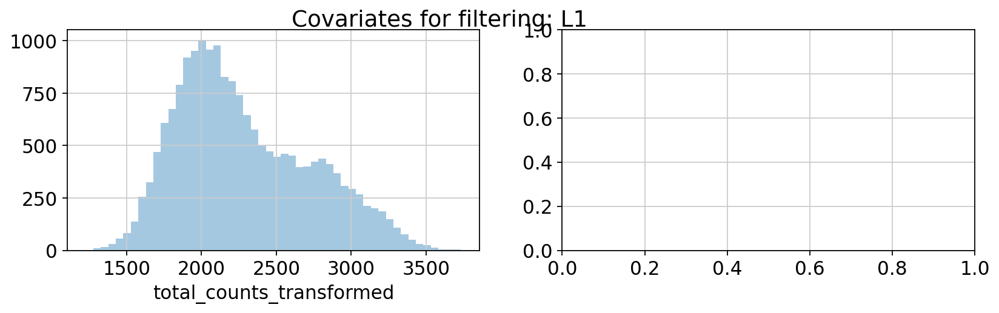

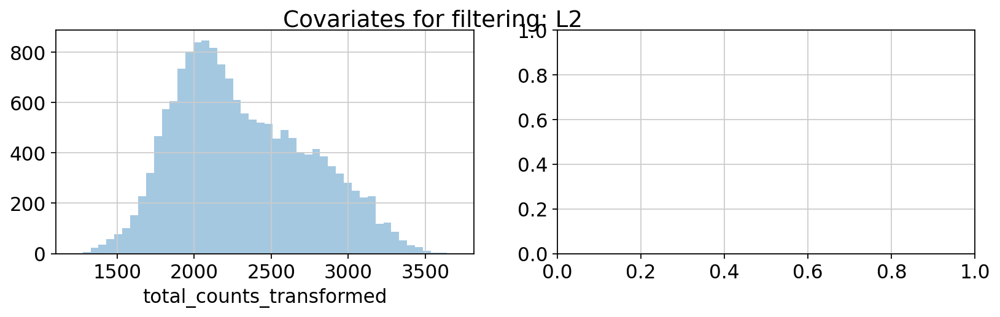

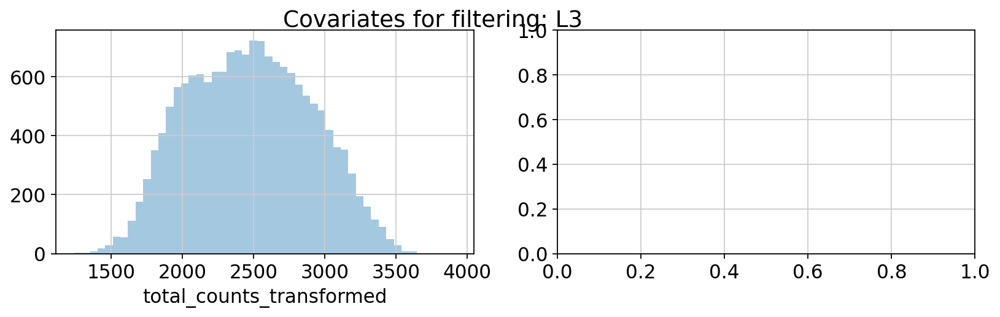

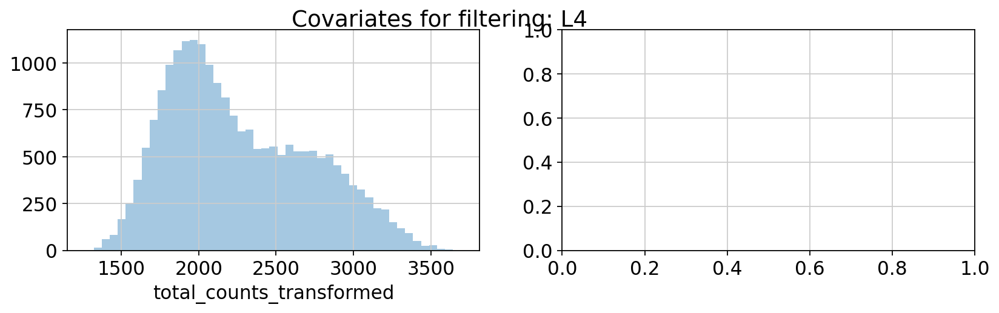

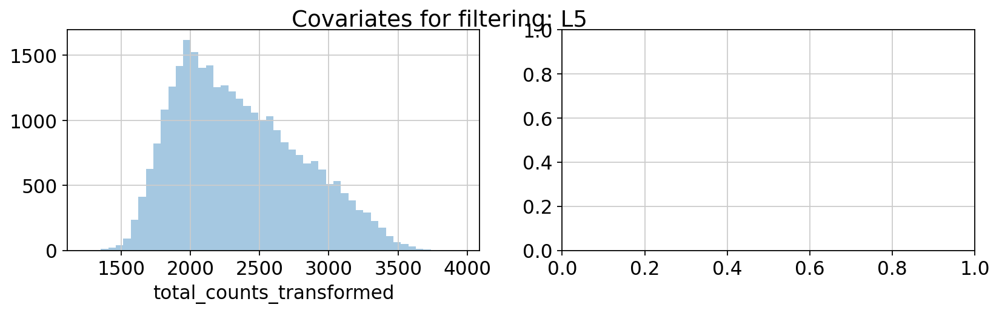

...

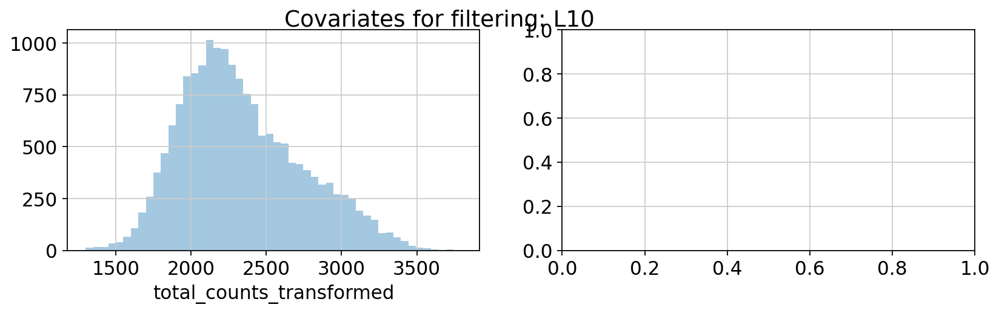

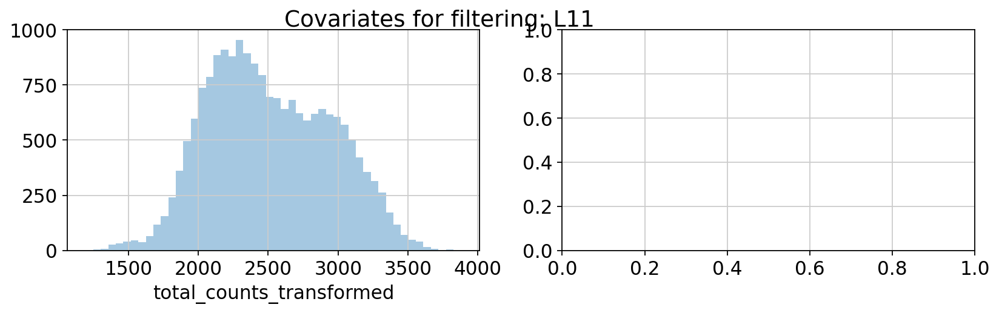

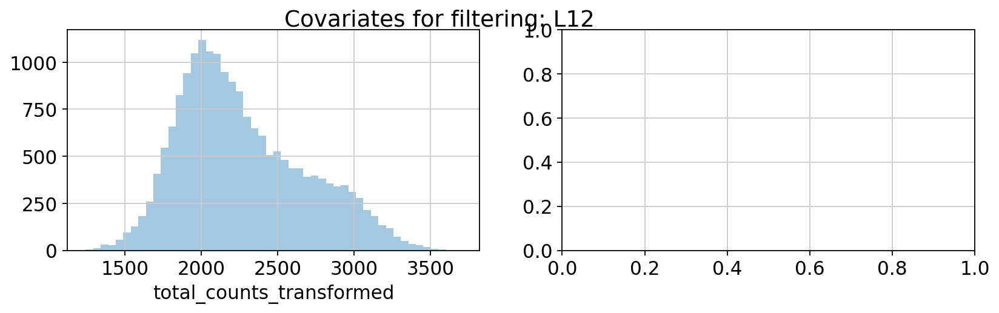

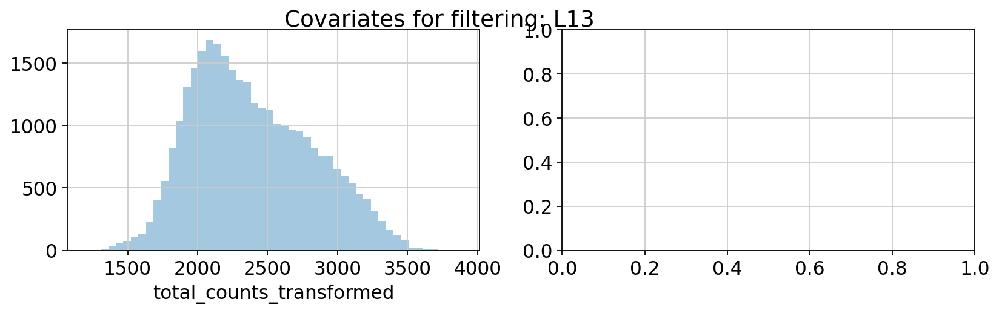

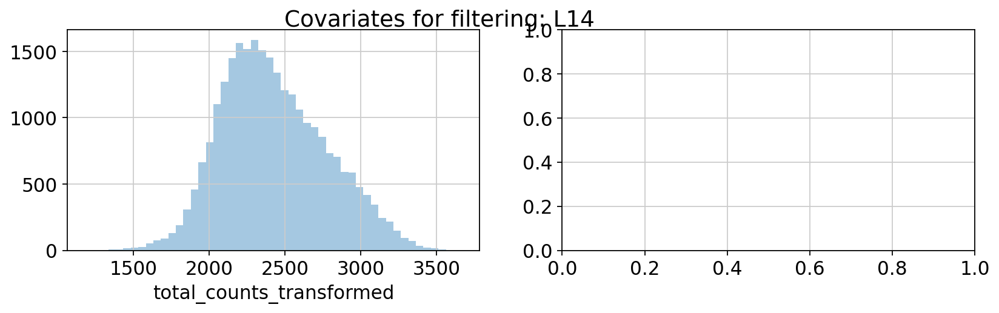

In [84]:
for key in anndata_dict:
    anndata_dict[key].obs['total_counts_transformed'] = anndata_dict[key].X.sum(axis=1)
    
    fig, axs = plt.subplots(1, 2, figsize=(12, 3))
    fig.suptitle("Covariates for filtering: " + key )

    sns.distplot( anndata_dict[key].obs['total_counts_transformed'], kde=False, ax=axs[0])